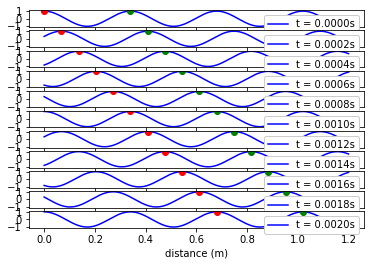

In [1]:
import matplotlib.pyplot as plt
from math import pi,cos

def f(x,t,c,T):
    return cos(2*pi*(t/T-x/(c*T)))



def affiche(c,T,tmax,xmax):
    dt=tmax/10.
    dx=xmax/10000.
    
    x=[]
    for i in range(10000):
        x.append(i*dx)

    fig = plt.figure("visualiser la propagation d'une onde")
    for i in range(0,11):
        y=[]
        plt.subplot(11,1,i+1)
        
        for j in range(10000):
            y.append(f(x[j],i*dt,c,T))

        plt.plot(x,y,"blue",label="t = {:.4f}s".format(i*dt))
        plt.plot([c*i*dt],[f(c*i*dt,i*dt,c,T)],"o",color="red")
        plt.plot([c*i*dt+c*T],[f(c*i*dt+c*T,i*dt,c,T)],"o",color="green")
        plt.legend(loc='upper right',framealpha=1.)

    plt.xlabel("distance (m)")
    plt.show()

affiche(c = 340,T = 1/1000., tmax = 0.002, xmax = 1.2) #utilise la fonction affiche pour une onde de célérité 340 m/s, de fréquence 1kHz 

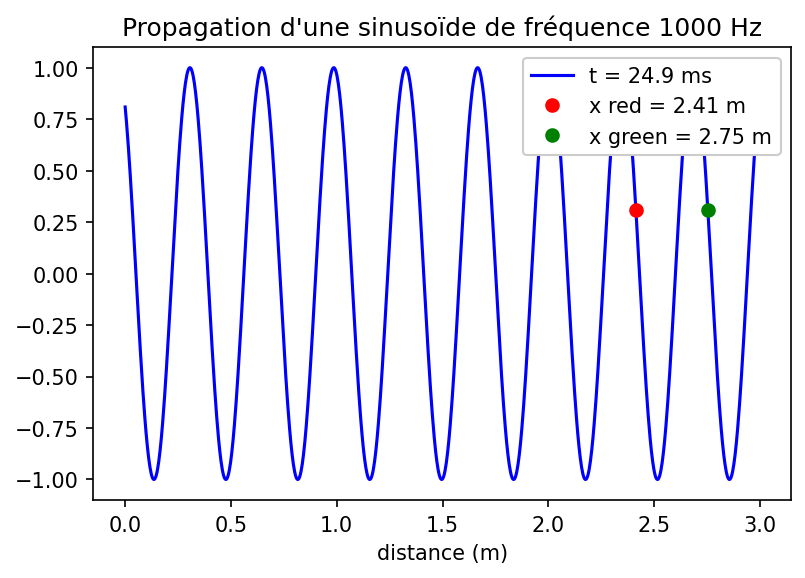

In [2]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from math import pi,cos

#On crée la figure une fois puis on la modifie régulièrement dans le temps
plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi'] = 150  
plt.ioff()
fig = plt.figure("animation propagation")
ax1 = fig.add_subplot(1,1,1)



#Conditions de la simulation
c = 340.
T = 1/1000.
dt = T/10.
xmax=3.
ig=0
ir=0

#Création de la liste des valeurs de x
x=[i*xmax/1000. for i in range(1000)]

def f(x,t,c,T):
    return cos(2*pi*(t/T-x/(c*T)))
    
def anime(i):
    global c,T,dt,xmax,ig,ir,x    

    #Création de la liste des valeurs de y à l'instant i*dt
    y=[]
    for j in range(1000):
        y.append(f(x[j],i*dt,c,T))

    #On efface le graphique précédent
    ax1.clear() 
    plt.title("Propagation d'une sinusoïde de fréquence 1000 Hz")
    #On trace le nouveau graphique
    ax1.plot(x,y,"blue",label="t = {:.1f} ms".format(1000*i*dt))
    
    #Si le point rouge sort de l'écran, il repart à gauche et on synchronise avec le vert
    if c*(i-ir)*dt>xmax:
        ir=i
        ig=ir

    #On trace les points
    ax1.plot([c*(i-ir)*dt],[f(c*(i-ir)*dt,i*dt,c,T)],"o",color="red",label="x red = {:.2f} m".format(c*(i-ir)*dt))
    if c*(i-ig)*dt+c*T<xmax:
        ax1.plot([c*(i-ig)*dt+c*T],[f(c*(i-ig)*dt+c*T,i*dt,c,T)],"o",color="green",label="x green = {:.2f} m".format(c*(i-ig)*dt+c*T))

    #On ajoute la légende et la grandeur sur l'axe des abscisses
    ax1.legend(loc='upper right',framealpha=1.)
    plt.xlabel("distance (m)")

animation.FuncAnimation(fig,anime,interval=50, frames = 250)  # prepare les 250 images demandées pour l'animation